| Nombre | Email |
|:----------:|:----------:|
|Néstor David Bohorquez Galeano | ndbohorquezg@udistrital.edu.co |
| Carolina Días Perez | carolina.zerep159@gmail.com |
| Sergio José Gamboa Candila | sjgc16@gmail.com |

# **HUPI BI/BA Final Project**

---
> ## Problem Understanding
---

This dataset contains house sale prices for King County, which includes Seattle. It includes homes sold between May 2014 and May 2015.

In [ ]:
from google.colab import files
from IPython.display import Image

uploaded = files.upload()

Saving cover_page1.jpg to cover_page1.jpg


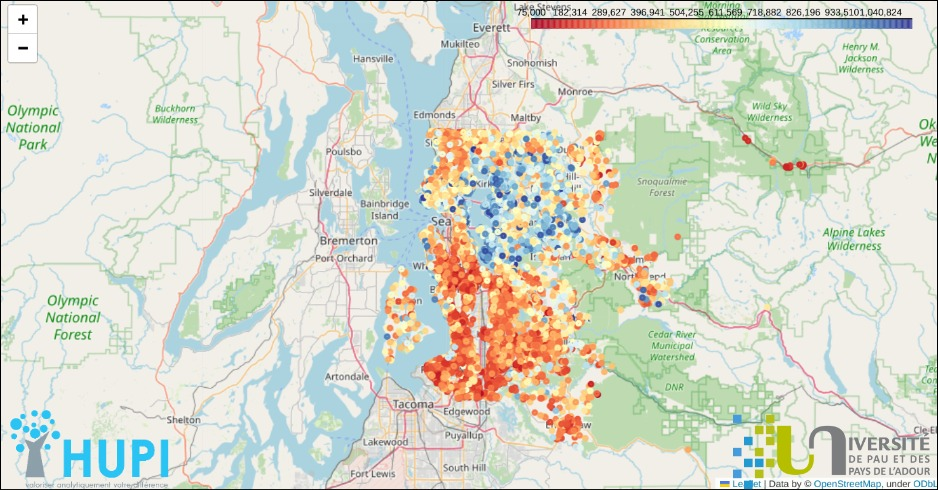

In [ ]:
Image('cover_page1.jpg', width=900)

---
>> ### Context
---

Based on the dataset that contains house sale prices for King County, which includes Seattle, predict the price of a house depending on its characteristics.

---
> ## Data Acquisition
---

---
>> ### Data Preparation
---

---
>>> #### Libraries imported
---

In [ ]:
# libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap, to_hex

import folium
from folium import plugins

from plotly import express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, chi2

from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error

# Modelization
import keras
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import mean_absolute_error

---
>>> #### Dataset description
---

In [ ]:
url = 'https://drive.google.com/file/d/1U4kRjiL5kXNI2zXMPluy_x1RPIyKz1Dq/view?usp=drive_link'
path = 'https://drive.google.com/uc?export=download&id='+url.split('/')[-2]
df = pd.read_csv(path)

df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [ ]:
# Get general information about the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [ ]:
# Descriptive statistics
df.iloc[:, 1:].describe().applymap(lambda x: "{:.5f}".format(x))

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000,21613.00000
mean,540088.14177,3.37084,2.11476,2079.89974,15106.96757,1.49431,0.00754,0.23430,3.40943,7.65687,1788.39069,291.50905,1971.00514,84.40226,98077.93980,47.56005,-122.21390,1986.55249,12768.45565
std,367127.19648,0.93006,0.77016,918.44090,41420.51152,0.53999,0.08652,0.76632,0.65074,1.17546,828.09098,442.57504,29.37341,401.67924,53.50503,0.13856,0.14083,685.39130,27304.17963
min,75000.00000,0.00000,0.00000,290.00000,520.00000,1.00000,0.00000,0.00000,1.00000,1.00000,290.00000,0.00000,1900.00000,0.00000,98001.00000,47.15590,-122.51900,399.00000,651.00000
25%,321950.00000,3.00000,1.75000,1427.00000,5040.00000,1.00000,0.00000,0.00000,3.00000,7.00000,1190.00000,0.00000,1951.00000,0.00000,98033.00000,47.47100,-122.32800,1490.00000,5100.00000
50%,450000.00000,3.00000,2.25000,1910.00000,7618.00000,1.50000,0.00000,0.00000,3.00000,7.00000,1560.00000,0.00000,1975.00000,0.00000,98065.00000,47.57180,-122.23000,1840.00000,7620.00000
75%,645000.00000,4.00000,2.50000,2550.00000,10688.00000,2.00000,0.00000,0.00000,4.00000,8.00000,2210.00000,560.00000,1997.00000,0.00000,98118.00000,47.67800,-122.12500,2360.00000,10083.00000
max,7700000.00000,33.00000,8.00000,13540.00000,1651359.00000,3.50000,1.00000,4.00000,5.00000,13.00000,9410.00000,4820.00000,2015.00000,2015.00000,98199.00000,47.77760,-121.31500,6210.00000,871200.00000


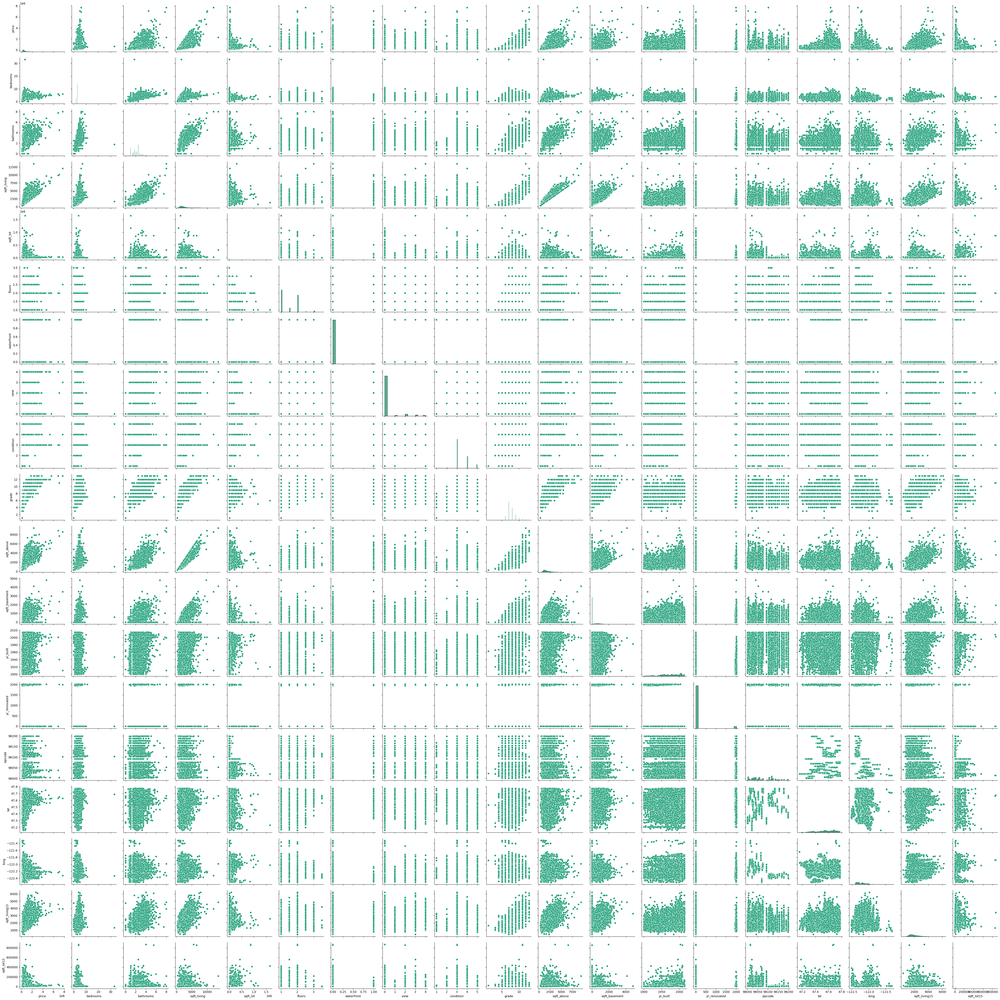

In [ ]:
  # Ploting pairwise relationships in a dataset
sns.set_palette("Dark2")
sns.pairplot(df.iloc[:,1:])

---
>>> #### Data distribution
---

In [ ]:
# Get the column names (excluding non-numeric columns)
numeric_columns = df.select_dtypes(include=['int64','float64']).columns
numeric_columns = [col for col in numeric_columns if col not in ['id', 'waterfront', 'view']]
# Create subplots with subplot titles
fig = make_subplots(
    rows=len(numeric_columns), cols=2,
    subplot_titles=["Histogram", "Box Plot"],
    column_widths=[0.4, 0.6]
)

# Iterate through each column and create subplots
for i, col in enumerate(numeric_columns, start=1):
    # Plot histogram in the first subplot
    fig.append_trace(go.Histogram(x=df[col]), row=i, col=1)

    # Plot box plot in the second subplot
    fig.append_trace(go.Box(x=df[col], name=col), row=i, col=2)

# Update layout properties
fig.update_layout(
    height=290 * len(numeric_columns),
    width=900,
    title_text="Distribution Plots for Numeric Attributes",
    showlegend=False,
    title_x=0.5
)

# Show the figure
fig.show()

---
>>> #### Filters

In [ ]:
# Filtering dataset for remove inconsistent data

# Copy of the original dataset
filt_df = df.copy()

# The lot area should be more than living area
filt_df = filt_df[df['sqft_lot'] > filt_df['sqft_living']]

# The lot area makeover in 2015 shoulbe more than living area makeover in 2015
filt_df = filt_df[filt_df['sqft_lot15'] > filt_df['sqft_living15']]

# It is not possible to have a renovation after the sale date
filt_df = filt_df[(filt_df['date'].apply(lambda x: int(x[:4])))>filt_df['yr_renovated']]

# Printing the number of deleted rows after filtering
print('\033[1m Number of rows removed: \033[0m', df.shape[0]-filt_df.shape[0])

 Number of rows removed:  1033


---
>>> #### Outliers: IRQ method

In [ ]:
# Function for showing and returning outlier indexes
def outliers(df, columns):
  excluded_rows = set()

  for column in columns:
    # Calculate IQR for the current column
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    # Define lower and upper bounds for filtering
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify rows to be excluded
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)].index
    excluded_rows.update(outliers)

    print(f'\033[1m Number of rows removed for {column}: \033[0m', len(outliers))

  return excluded_rows

In [ ]:
# Columns for reviewing outliers
columns_to_process = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'sqft_lot15']

# Number of outliers per column selected
excluded_rows = outliers(filt_df, columns_to_process)

 Number of rows removed for price:  1090
 Number of rows removed for bedrooms:  529
 Number of rows removed for bathrooms:  263
 Number of rows removed for sqft_living:  514
 Number of rows removed for sqft_lot:  2399
 Number of rows removed for sqft_above:  547
 Number of rows removed for sqft_basement:  418
 Number of rows removed for sqft_lot15:  2194


In [ ]:
# Columns for removing outliers
columns_to_process = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_above', 'sqft_basement']

# Number of outliers per column selected
excluded_rows = outliers(filt_df, columns_to_process)

# Removing outliers and saving the new dataframe into another one
filt_outl_df = filt_df.drop(excluded_rows)

 Number of rows removed for price:  1090
 Number of rows removed for bedrooms:  529
 Number of rows removed for bathrooms:  263
 Number of rows removed for sqft_living:  514
 Number of rows removed for sqft_above:  547
 Number of rows removed for sqft_basement:  418


In [ ]:
print(df.shape, filt_df.shape, filt_outl_df.shape)

# Printing the number of deleted rows after applying the outliers function
print('\033[1m Number of rows removed: \033[0m', df.shape[0]-filt_outl_df.shape[0])

(21613, 21) (20580, 21) (18505, 21)
 Number of rows removed:  3108


In [ ]:
# Percentage of data removed
print('\033[1m Percentage of total rows removed: \033[0m', round((((df.shape[0]-filt_outl_df.shape[0])+(df.shape[0]-filt_df.shape[0]))/df.shape[0])*100, 2))

 Percentage of total rows removed:  19.16


In [ ]:
# Data distribution and visualization after removing outliers
numeric_columns = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_above', 'sqft_basement']

fig = make_subplots(
    rows=len(numeric_columns), cols=2,
    subplot_titles=["Histogram", "Box Plot"],
    column_widths=[0.4, 0.6]
)

for i, col in enumerate(numeric_columns, start=1):
    fig.append_trace(go.Histogram(x=filt_outl_df[col]), row=i, col=1)
    fig.append_trace(go.Box(x=filt_outl_df[col], name=col), row=i, col=2)

fig.update_layout(
    height=290 * len(numeric_columns),
    width=900,
    title_text="Distribution Plots for Numeric Attributes",
    showlegend=False,
    title_x=0.5
)
fig.show()

---
>> ### Feature Engineering
---

---
>>> #### Transformations
---

In [ ]:
# Copying the previous dataframe
dfT = filt_outl_df.copy()

In [ ]:
#Create the function to convert and fix the number of bathrooms is only possible to have an entire number or a half number.
def custom_round(bathroom_value):
    if bathroom_value % 1 == 0.25:
        return int(bathroom_value)  # Round down
    elif bathroom_value % 1 == 0.75:
        return int(bathroom_value) + 1  # Round up
    else:
        return bathroom_value

# Apy the function to 'bathrooms' column
dfT['bathrooms'] = dfT['bathrooms'].map(custom_round)

# Printing unique values for 'bathrooms' column
dfT['bathrooms'].unique()

array([1. , 2. , 3. , 1.5, 2.5, 4. , 3.5, 0.5])

In [ ]:
# Format for the 'date' column
dfT['date'] = dfT['date'].astype(str).apply(lambda x: x[:4] + "-"+  x[4:6] + "-" + x[6:8])

# Printing unique values for 'date' column
print(filt_outl_df['date'].head(n=2))
print('---------------------------\n')
print(dfT['date'].head(n=2))

0    20141013T000000
1    20141209T000000
Name: date, dtype: object
---------------------------

0    2014-10-13
1    2014-12-09
Name: date, dtype: object


---
>>> #### Discretization
---

In [ ]:
# Specify the bins and labels
bins = [dfT['price'].min(), dfT['price'].quantile(1/3), dfT['price'].quantile(2/3), dfT['price'].max()]
labels = ['Low', 'Medium', 'High']

# Discretize the 'price' column
dfT['price_category'] = pd.cut(dfT['price'], bins=bins, labels=labels, include_lowest=True)

# Display the updated DataFrame
print('\033[1m Bins for the "price" colunm: \033[0m', [f'{val:.2f}' for val in bins])
display(dfT[['price', 'price_category']].head())

 Bins for the "price" colunm:  ['78000.00', '348000.00', '530000.00', '1145000.00']


,price,price_category
0,221900.0,Low
1,538000.0,High
2,180000.0,Low
3,604000.0,High
4,510000.0,Medium



---
>>> #### Feature Creation
---

In [ ]:
# Change 'date' and 'date_building' to datetime type
dfT['date'] = pd.to_datetime(dfT['date'])
dfT['yr_built'] = pd.to_datetime(dfT['yr_built'])

# Create age column with the sustraction of date less year built
dfT['age'] = dfT['date'].dt.year - dfT['yr_built'].dt.year

---
>> ### Data Analysis / Data Visualization
---

---
>>> #### Categorical variables
---

---
>>> #### Numerical variables
---

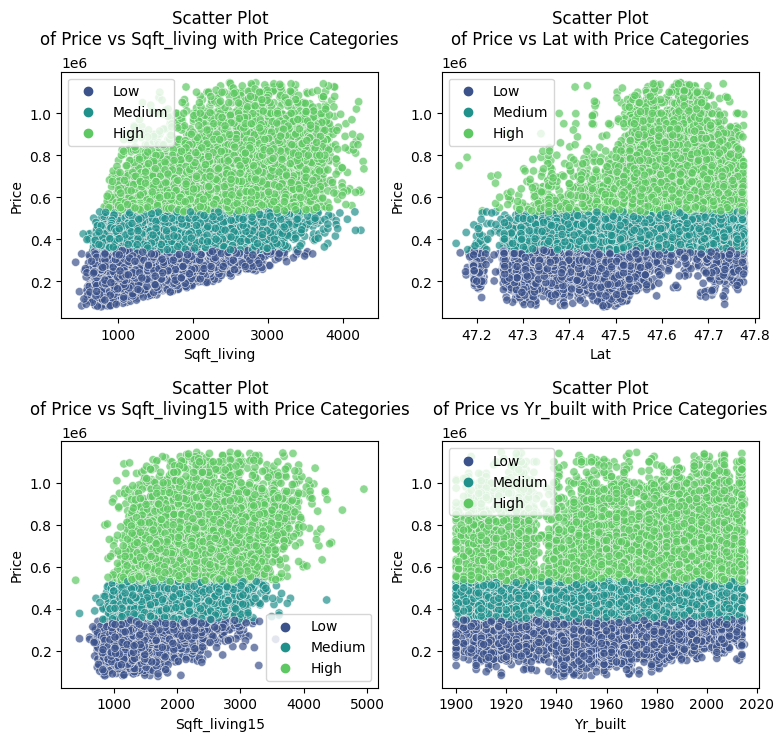

In [ ]:
# Columns to visualize against 'price'
columns_to_visualize = ['sqft_living', 'lat', 'sqft_living15', 'yr_built']

# Create subplots with two columns per row
num_rows = (len(columns_to_visualize) + 1) // 2
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(9, 4 * num_rows))
axes = axes.flatten()

# Iterate over columns for create scatter plots
for i, column in enumerate(columns_to_visualize):
    sns.scatterplot(x=column, y='price', hue='price_category', data=dfT, palette='viridis', alpha=0.7, ax=axes[i])

    # Set plot labels and title
    axes[i].set_xlabel(column.capitalize())
    axes[i].set_ylabel('Price')
    axes[i].set_title(f'Scatter Plot\nof Price vs {column.capitalize()} with Price Categories', pad=20)

    axes[i].legend()

# Adjust layout
plt.subplots_adjust(hspace=0.5)

# Show the plots
plt.show()

---
>>> #### Georeferencing
---

In [ ]:
# Determined the max and min values for the 'price' column
min_price = filt_outl_df['price'].min()
max_price = filt_outl_df['price'].max()

# Create a folium map centered around the first row's location
map_center = [filt_outl_df['lat'].iloc[0], filt_outl_df['long'].iloc[0]]
my_map = folium.Map(location=map_center, zoom_start=9, width='80%', height='70%')

# Create a color map using LinearSegmentedColormap
cmap = plt.cm.get_cmap('RdYlBu')  # Use 'RdYlBu' colormap
norm = plt.Normalize(vmin=min_price, vmax=max_price)
colormap_colors = [to_hex(cmap(norm(val))) for val in np.linspace(min_price, max_price, num=256)]

# Plot each row as a point with color based on the 'price' variable
for index, row in filt_outl_df.iterrows():
    color = to_hex(cmap(norm(row['price'])))
    folium.CircleMarker(location=[row['lat'], row['long']], radius=2, color=color, fill=True).add_to(my_map)

# Create a color bar with specific tick positions
colormap = folium.LinearColormap(colors=colormap_colors, vmin=min_price, vmax=max_price)

# Add the color bar to the map
colormap.add_to(my_map)

# Display the map
my_map

<ipython-input-15-1490a4294874>:10: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



---
>> ### Data Scaling & Selection
---

---
>>> #### Normalization
---

In [ ]:
#Label encoding
dfT['price_category'] = preprocessing.LabelEncoder().fit_transform(dfT['price_category'])#Low:1;High:0;Medium:2

dfT[['price','price_category']].head()

,price,price_category
0,221900.0,1
1,538000.0,0
2,180000.0,1
3,604000.0,0
4,510000.0,2


In [ ]:
#Normalizing the data
columns_to_exclude = ['id', 'date','yr_built']

# Select columns to scale
columns_to_scale = [col for col in dfT.columns if col not in columns_to_exclude]

# Apply StandardScaler to the selected columns
sc = StandardScaler()
dfN = sc.fit_transform(dfT[columns_to_scale])

# Create a DataFrame with the standardized data and original column names
df_N = pd.DataFrame(data=dfN, columns=columns_to_scale)

df_N.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price_category,age
0,-1.212375,-0.402294,-1.543348,-1.095749,-0.229254,-0.868382,-0.053085,-0.262473,-0.654311,-0.484311,-0.754617,-0.657698,-0.186182,1.881756,-0.288986,-0.333226,-0.983503,-0.270097,-0.001919,-0.693024
1,0.344206,-0.402294,-0.042972,0.905922,-0.188167,1.158920,-0.053085,-0.262473,-0.654311,-0.484311,0.707241,0.395175,5.365031,0.892783,1.171584,-0.770324,-0.387939,-0.191645,-1.226650,-0.693024
2,-1.418705,-1.684713,-1.543348,-1.686170,-0.116986,-0.868382,-0.053085,-0.262473,-0.654311,-1.487576,-1.360033,-0.657698,-0.186182,-0.917223,1.289237,-0.164027,1.364720,-0.174961,-0.001919,1.442953
3,0.669212,0.880126,1.457404,0.027491,-0.246030,-0.868382,-0.053085,-0.262473,2.399800,-0.484311,-0.946578,1.737589,-0.186182,1.098042,-0.222153,-1.292021,-0.949471,-0.295735,-1.226650,-0.693024
4,0.206325,-0.402294,-0.042972,-0.375724,-0.166539,-0.868382,-0.053085,-0.262473,-0.654311,0.518955,-0.016305,-0.657698,-0.186182,-0.058870,0.446172,1.161365,-0.200762,-0.197009,1.222811,1.442953


---
>>> #### Feature Selection
---

In [ ]:
X = np.abs(StandardScaler().fit_transform(df.iloc[:, 2:].values))
y = df.iloc[:, 1].values

# Exclude 'price' from features before chi-squared test
columns_without_price = df.columns[2:][df.columns[2:] != 'price']

# Select features
best_features = SelectKBest(score_func=chi2, k=10)
feature_scores = pd.DataFrame(best_features.fit(X[:, df.columns[2:] != 'price'], y).scores_, columns=['Score'])

# Concatenate feature names and scores
feature_scores = pd.concat([pd.DataFrame(columns_without_price, columns=['Specs (Chi2)']), feature_scores], axis=1)

# Display the top 20 features based on chi-squared scores
display(feature_scores.nlargest(20, 'Score').reset_index(drop=True))
# Convert the array to a DataFrame
columns = df_N.columns[2:]

df_X = pd.DataFrame(X, columns=columns)

correlation_matrix = df_X.corr()

# Plot the heatmap
plt.figure(figsize=(18, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

In [ ]:
# Selected categories
selected_categories = ['bathrooms', 'lat', 'bedrooms', 'grade', 'sqft_above','view', 'sqft_basement', 'sqft_lot', 'waterfront', 'sqft_lot15', 'yr_renovated','age']

---
> ## Modelization
---

---
>> ### Regression
---

In [ ]:
X = df_N[selected_categories].values
y = dfT['price'].values

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the degree of the polynomial
degree = 2

# Generate polynomial features
poly_features = PolynomialFeatures(degree=degree)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

# Fit linear regression on the polynomial features
model = LinearRegression()
model.fit(X_train_poly, y_train)

# Predictions on training set
y_train_pred = model.predict(X_train_poly)

# Predictions on test set
y_test_pred = model.predict(X_test_poly)

# Evaluate the model
train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))

print(f'Training RMSE: {train_rmse:.2f}')
print(f'Test RMSE: {test_rmse:.2f}')

---
>> ### Classification
---

---
>> ### Convolutional neural network (CNN)
---

In [ ]:
# Select the columns for the Model
X = df_N[selected_categories].values
y = dfT['price'].values.reshape(-1, 1)

---
>> #### Continuous Model (CNN)
---

In [ ]:
# Split the dataset into train and test
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size = 0.2, random_state=1234)

In [ ]:
# Neural network
model = Sequential()
model.add(Dense(16, input_dim=12, activation='relu'))
model.add(Dense(12, activation='relu'))
model.add(Dense(1, activation='linear'))

In [ ]:
# Setup hyperparamters of the model
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_absolute_error'])  # Use mean squared error for regression

In [ ]:
# Variables for monitor the model
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, verbose=1)
checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', verbose=1, save_best_only=True)

In [ ]:
history = model.fit(X_train, y_train, callbacks=[earlystop, checkpoint], epochs=150, batch_size=64, validation_split=0.2)

Epoch 1/150
175/186 [===========================>..] - ETA: 0s - loss: 262389612544.0000 - mean_absolute_error: 469855.5938
Epoch 1: val_loss improved from inf to 257612054528.00000, saving model to best_model.h5
186/186 [==============================] - 2s 4ms/step - loss: 261672828928.0000 - mean_absolute_error: 469111.9688 - val_loss: 257612054528.0000 - val_mean_absolute_error: 466922.0938
Epoch 2/150
 71/186 [==========>...................] - ETA: 0s - loss: 264335294464.0000 - mean_absolute_error: 471344.1250

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



175/186 [===========================>..] - ETA: 0s - loss: 262137430016.0000 - mean_absolute_error: 469496.8125
Epoch 2: val_loss improved from 257612054528.00000 to 257534787584.00000, saving model to best_model.h5
186/186 [==============================] - 1s 3ms/step - loss: 261633277952.0000 - mean_absolute_error: 469071.6875 - val_loss: 257534787584.0000 - val_mean_absolute_error: 466843.5938
Epoch 3/150
160/186 [========================>.....] - ETA: 0s - loss: 260649549824.0000 - mean_absolute_error: 468152.8438
Epoch 3: val_loss improved from 257534787584.00000 to 257305853952.00000, saving model to best_model.h5
186/186 [==============================] - 1s 3ms/step - loss: 261485297664.0000 - mean_absolute_error: 468923.6562 - val_loss: 257305853952.0000 - val_mean_absolute_error: 466614.0000
Epoch 4/150
178/186 [===========================>..] - ETA: 0s - loss: 260794040320.0000 - mean_absolute_error: 468233.3125
Epoch 4: val_loss improved from 257305853952.00000 to 25684957

In [ ]:
# Save the best model
model.load_weights('best_model.h5')

In [ ]:
#Save the prediction using the best model
y_pred = model.predict(X_test)

116/116 [==============================] - 0s 1ms/step


In [ ]:
#For the case of a continuos variable we use MAE as a parameter of error
mae = mean_absolute_error(y_test, y_pred)
print('Mean Absolute Error is:', round(mae,2))

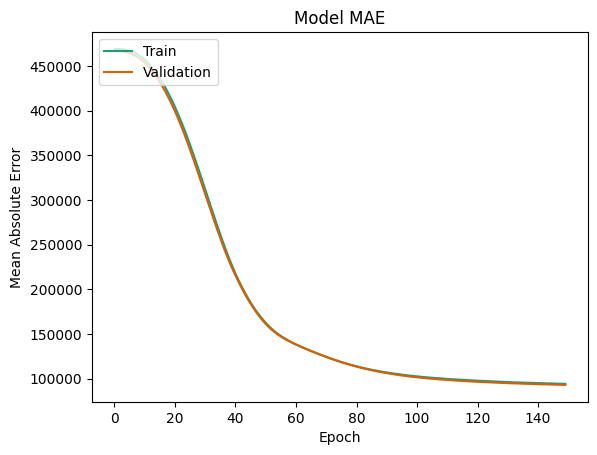

In [ ]:
# Plot of the MAE
plt.plot(history.history['mean_absolute_error'])
plt.plot(history.history['val_mean_absolute_error'])
plt.title('Model MAE')
plt.ylabel('Mean Absolute Error')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

---
>> #### Discret Model (CNN)
---

In [ ]:
# Select the columns for the Model
y = dfT['price_category'].values.reshape(-1, 1)

In [ ]:
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder()
y = ohe.fit_transform(y).toarray()

In [ ]:
test = list()
for i in range(len(y)):
    test.append(np.argmax(y[i]))

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size = 0.2, random_state=1234)

In [ ]:
# Neural network
model = Sequential()
model.add(Dense(16, input_dim=12, activation='relu'))
model.add(Dense(12, activation='relu'))
model.add(Dense(3, activation='softmax'))

In [ ]:
# Setup hyperparamters of the model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
# Variables for monitor the model
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=50, verbose=1)
checkpoint = tf.keras.callbacks.ModelCheckpoint('best.model', monitor='val_accuracy', verbose=1, save_best_only=True)

In [ ]:
history = model.fit(X_train, y_train, callbacks=[earlystop, checkpoint], epochs=150, batch_size=64, validation_split=0.2)

Epoch 1/150
185/186 [============================>.] - ETA: 0s - loss: 0.9603 - accuracy: 0.5470
Epoch 1: val_accuracy improved from -inf to 0.64336, saving model to best.model
186/186 [==============================] - 6s 18ms/step - loss: 0.9602 - accuracy: 0.5471 - val_loss: 0.8101 - val_accuracy: 0.6434
Epoch 2/150
186/186 [==============================] - ETA: 0s - loss: 0.7114 - accuracy: 0.6797
Epoch 2: val_accuracy improved from 0.64336 to 0.68288, saving model to best.model
186/186 [==============================] - 2s 12ms/step - loss: 0.7114 - accuracy: 0.6797 - val_loss: 0.6977 - val_accuracy: 0.6829
Epoch 3/150
171/186 [==========================>...] - ETA: 0s - loss: 0.6537 - accuracy: 0.7046
Epoch 3: val_accuracy improved from 0.68288 to 0.69943, saving model to best.model
186/186 [==============================] - 1s 7ms/step - loss: 0.6496 - accuracy: 0.7063 - val_loss: 0.6575 - val_accuracy: 0.6994
Epoch 4/150
168/186 [==========================>...] - ETA: 0s - los

In [ ]:
model.load_weights('best.model')

In [ ]:
y_pred = model.predict(X_test)
#Converting predictions to label
pred = list()
for i in range(len(y_pred)):
    pred.append(np.argmax(y_pred[i]))
#Converting one hot encoded test label to label
test = list()
for i in range(len(y_test)):
    test.append(np.argmax(y_test[i]))

116/116 [==============================] - 0s 2ms/step


In [ ]:
from sklearn.metrics import accuracy_score
a = accuracy_score(pred,test)
print('Accuracy is:', round(a*100,2))

Accuracy is: 80.17


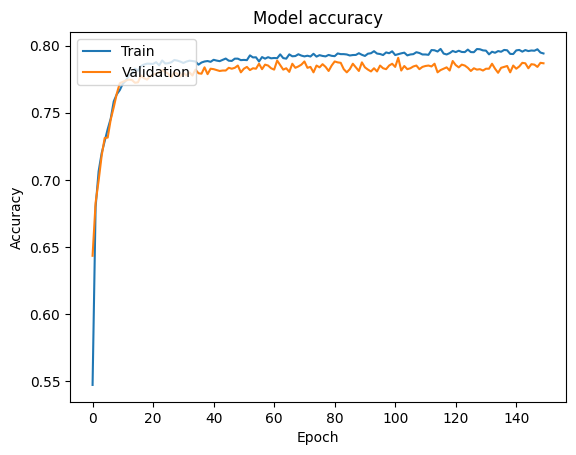

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

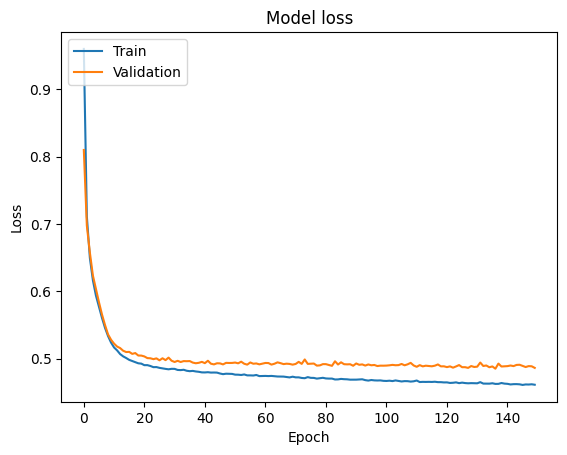

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

116/116 [==============================] - 0s 3ms/step


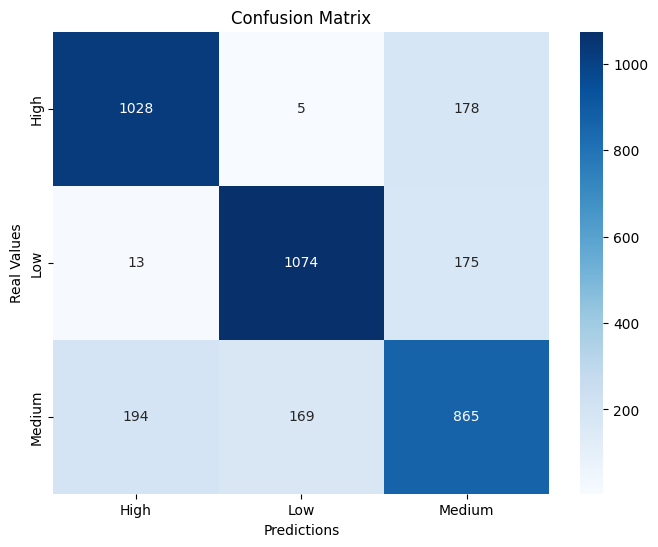

In [ ]:
# Obtain the labels using one-hot format
y_pred_onehot = model.predict(X_test)

# Convert the predicted and real labels to class labels
y_pred_classes = np.argmax(y_pred_onehot, axis=1)
y_true_classes = np.argmax(y_test, axis=1)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Show confusion matrx
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['High', 'Low', 'Medium'], yticklabels=['High', 'Low', 'Medium'])
plt.xlabel('Predictions')
plt.ylabel('Real Values')
plt.title('Confusion Matrix')
plt.show()
